In [0]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
import math

from tensorflow import keras
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

%load_ext tensorboard

paper:<br/>
https://www.nature.com/articles/s41598-019-55320-6<br/>

In [0]:
# !rm -r logs_Autoencoder
# !rm -r logs_PredictOne
# !rm -r logs1
# !rm -r logs2
# !rm -r logs3

![LSTMAE](https://media.springernature.com/full/springer-static/image/art%3A10.1038%2Fs41598-019-55320-6/MediaObjects/41598_2019_55320_Fig3_HTML.png?as=webp)

Train Score: 2.96 RMSE
Test Score: 163.38 RMSE


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:63: RuntimeWarning: Mean of empty slice
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:69: RuntimeWarning: Mean of empty slice


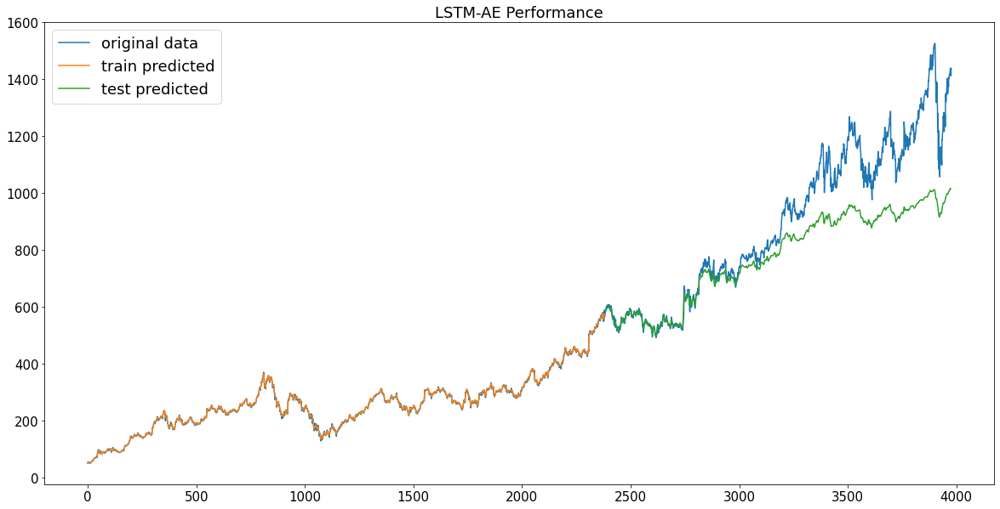

In [0]:
class LSTMAE:
  def __init__(self, lantent_dim=32):
    self.lantent_dim = lantent_dim
    self.look_back = 30
    self.encoder, self.autoencoder = self.get_model()
    self.data_process()

  def get_model(self):
    enc_inp = keras.Input(shape=(1, self.look_back,), name='lstm_enc_inp')
    enc_out = keras.layers.LSTM(self.lantent_dim, recurrent_dropout=0.2, recurrent_regularizer=keras.regularizers.l1_l2(l1=5e-5, l2=5e-5), activity_regularizer=keras.regularizers.l1_l2(l1=2e-5, l2=2e-5))(enc_inp)
    encoder = keras.Model(enc_inp, enc_out, name='LSTM_encoder')

    dec_inp = keras.Input(shape=(self.lantent_dim), name='lstm_enc_inp')
    x = keras.layers.RepeatVector(1)(dec_inp)
    dec_out = keras.layers.LSTM(self.look_back, return_sequences=True, recurrent_dropout=0.2, recurrent_regularizer=keras.regularizers.l1_l2(l1=2e-5, l2=2e-5), activity_regularizer=keras.regularizers.l1_l2(l1=2e-5, l2=2e-5))(x)
    decoder = keras.Model(dec_inp, dec_out, name='LSTM_decoder')

    autocoder_inp = keras.Input(shape=(1, self.look_back,), name='lstm_autoencoder_inp')
    encoder_out = encoder(autocoder_inp)
    autocoder_out = decoder(encoder_out)
    autocoder = keras.Model(autocoder_inp, autocoder_out, name='LSTM_autoencoder')
    return encoder, autocoder

  def data_process(self, input_file="GOOG.csv", test_size=0.4):
    col_names = ['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']
    self.dataset = pd.read_csv(input_file, names=col_names, delimiter=',', index_col=None, usecols=[col_names[-2]]).to_numpy().reshape(-1, 1)
    self.min_max = MinMaxScaler(feature_range=(0, 1))
    dataset = self.min_max.fit_transform(self.dataset).reshape(-1)
    train_size = int((1 - test_size) * len(dataset))

    def moving_window(dataset):
      x = np.zeros((0, 1 ,self.look_back))
      for i in range(len(dataset) - self.look_back - 1):
        tmp = dataset[i : i + self.look_back][np.newaxis, np.newaxis, :]
        x = np.concatenate([x, tmp], axis=0)
      return x

    self.train_set = moving_window(dataset[:train_size])
    self.test_set = moving_window(dataset[train_size:])

  def fit(self, epochs=200, batch_size=30, log_dir='logs_Autoencoder'):
    self.autoencoder.compile(optimizer='adam', loss='mse')
    self.autoencoder.fit(self.train_set, self.train_set, epochs=epochs, batch_size=batch_size, verbose=0, callbacks=[keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)])

  def predict(self):
    trainPredict = self.autoencoder.predict(self.train_set).reshape(self.train_set.shape[0], self.look_back)
    testPredict = self.autoencoder.predict(self.test_set).reshape(self.test_set.shape[0], self.look_back)
    trainPredict = self.min_max.inverse_transform(trainPredict)
    testPredict = self.min_max.inverse_transform(testPredict)

    trainScore = math.sqrt(mean_squared_error(self.min_max.inverse_transform(self.train_set.reshape(self.train_set.shape[0], self.look_back)), trainPredict))
    print('Train Score: %.2f RMSE' % (trainScore))
    testScore = math.sqrt(mean_squared_error(self.min_max.inverse_transform(self.test_set.reshape(self.test_set.shape[0], self.look_back)), testPredict))
    print('Test Score: %.2f RMSE' % (testScore))
    return trainPredict, testPredict

  def price_plot(self, trainPredict, testPredict, title='LSTM-AE Performance'):
    trainPredictPlot = np.zeros((trainPredict.shape[0], self.dataset.shape[0]), dtype=np.float64)
    trainPredictPlot[:] = np.nan
    # trainPredictPlot每個row依據預測時間都擺著預測值
    for idx, p in enumerate(trainPredict):
      trainPredictPlot[idx, idx : self.look_back + idx] = p
    trainPredictPlot = np.nanmean(trainPredictPlot, axis=0)

    testPredictPlot = np.zeros((testPredict.shape[0], self.dataset.shape[0]), dtype=np.float64)
    testPredictPlot[:] = np.nan
    for idx, p in enumerate(testPredict):
      testPredictPlot[idx, trainPredict.shape[0] + self.look_back + idx : trainPredict.shape[0] + 2 * self.look_back + idx] = p
    testPredictPlot = np.nanmean(testPredictPlot, axis=0)

    plt.figure(figsize = (20,10))
    plt.plot(self.dataset, label='original data')
    plt.plot(trainPredictPlot, label='train predicted')
    plt.plot(testPredictPlot, label='test predicted')
    plt.title(title, fontsize=18)
    plt.legend(loc='upper left', prop={'size': 18})
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.show()


lstmae = LSTMAE()
lstmae.fit()
ae_trainPredict, ae_testPredict = lstmae.predict()
lstmae.price_plot(ae_trainPredict, ae_testPredict)

Train Score: 6.02 RMSE
Test Score: 18.73 RMSE


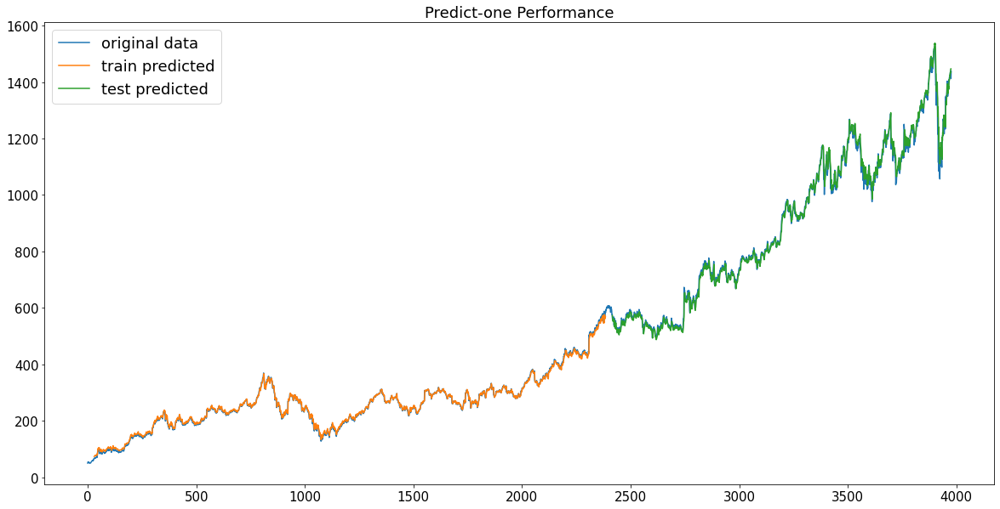

In [0]:
# Predict-one
class StockPrediction:
  def __init__(self, look_back=30):
    self.look_back = look_back
    self.model = self.get_model()
    self.data_process()

  def get_model(self):
    inp = keras.Input(shape=(1, self.look_back,), name='inp')
    x = keras.layers.LSTM(32, recurrent_regularizer=tf.keras.regularizers.l1_l2(l1=5e-5, l2=5e-5))(inp)
    x = keras.layers.Dropout(0.1)(x)
    x = keras.layers.BatchNormalization()(x)
    out = keras.layers.Dense(1)(x)
    return keras.Model(inp, out, name='LSTM')

  def data_process(self, input_file="GOOG.csv", test_size=0.4):
    col_names = ['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']
    self.dataset = pd.read_csv(input_file, names=col_names, delimiter=',', index_col=None, usecols=[col_names[-2]]).to_numpy().reshape(-1, 1)
    self.min_max = MinMaxScaler(feature_range=(0, 1))
    dataset = self.min_max.fit_transform(self.dataset).reshape(-1)
    train_size = int((1 - test_size) * len(dataset))

    def moving_window(dataset):
      x = np.zeros((0, 1 ,self.look_back))
      y = np.zeros((0,))
      for i in range(len(dataset) - self.look_back - 1):
        tmp = dataset[i : i + self.look_back][np.newaxis, np.newaxis, :]
        x = np.concatenate([x, tmp], axis=0)
        y = np.append(y, dataset[i + self.look_back])
      return x, y

    self.train_x, self.train_y = moving_window(dataset[:train_size])
    self.test_x, self.test_y = moving_window(dataset[train_size:])


  def fit(self, epochs=1000, batch_size=120, log_dir="./logs"):
    self.model.compile(loss='mse', optimizer='adam')
    self.model.fit(self.train_x, self.train_y, epochs=epochs, batch_size=batch_size, verbose=0, callbacks=[keras.callbacks.TensorBoard(log_dir=log_dir,  histogram_freq=1)])

  def predict(self):
    trainPredict = self.model.predict(self.train_x)
    testPredict = self.model.predict(self.test_x)

    trainPredict = self.min_max.inverse_transform(trainPredict).reshape(-1)
    trainY = self.min_max.inverse_transform(self.train_y.reshape(-1, 1)).reshape(-1)
    testPredict = self.min_max.inverse_transform(testPredict).reshape(-1)
    testY = self.min_max.inverse_transform(self.test_y.reshape(-1, 1)).reshape(-1)

    trainScore = math.sqrt(mean_squared_error(trainY, trainPredict))
    print('Train Score: %.2f RMSE' % (trainScore))
    testScore = math.sqrt(mean_squared_error(testY, testPredict))
    print('Test Score: %.2f RMSE' % (testScore))
    # trainPredict, testPredict: 1-d array
    return trainPredict, testPredict

  def price_plot(self, trainPredict, testPredict, title='Predict-one Performance'):
    '''self.dataset: (dataset size, 1) , trainPredict: (train size,), testPredict: (test size,)'''
    trainPredict = trainPredict.reshape(-1, 1)
    trainPredictPlot = np.empty_like(self.dataset, dtype=np.float64)
    trainPredictPlot[:] = np.nan
    trainPredictPlot[self.look_back : len(trainPredict)+ self.look_back] = trainPredict

    testPredict = testPredict.reshape(-1, 1)
    testPredictPlot = np.empty_like(self.dataset, dtype=np.float64)
    testPredictPlot[:] = np.nan
    testPredictPlot[len(trainPredict) + 2 * self.look_back  + 1: -1] = testPredict

    plt.figure(figsize = (20,10))
    plt.plot(self.dataset, label='original data')
    plt.plot(trainPredictPlot, label='train predicted')
    plt.plot(testPredictPlot, label='test predicted')
    plt.legend(loc='upper left', prop={'size': 18})
    plt.title(title, fontsize=18)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.show()


    
PredictOne = StockPrediction()
PredictOne.fit(log_dir="./logs_PredictOne")
trainPredict, testPredict = PredictOne.predict()
PredictOne.price_plot(trainPredict, testPredict)

In [0]:
pretrain_lstm1 = PredictOne.model.get_layer(index=1)
pretrain_lstm2 = lstmae.encoder.get_layer(index=1)

# Predict-five
class StockPredictions:
  def __init__(self, pretrain_layer=None, predicted_days=5):
    self.look_back = 30
    self.predicted_days = predicted_days
    self.model = self.get_model(pretrain_layer)
    self.data_process()

  def get_model(self, pretrain_layer):
    if pretrain_layer:
      inp = keras.Input(shape=(1, self.look_back,), name='inp')
      x = pretrain_layer(inp)
      x = keras.layers.Dropout(0.1)(x)
      x = keras.layers.BatchNormalization()(x)
      out = keras.layers.Dense(self.predicted_days, bias_regularizer=keras.regularizers.l1_l2(l1=1e-6, l2=1e-6))(x)
      return keras.Model(inp, out, name='LSTM5')

    inp = keras.Input(shape=(1, self.look_back,), name='inp')
    x = keras.layers.LSTM(32, recurrent_regularizer=tf.keras.regularizers.l1_l2(l1=5e-6, l2=5e-6))(inp)
    x = keras.layers.Dropout(0.1)(x)
    x = keras.layers.BatchNormalization()(x)
    out = keras.layers.Dense(self.predicted_days, bias_regularizer=keras.regularizers.l1_l2(l1=1e-6, l2=1e-6))(x)
    return keras.Model(inp, out, name='LSTM5')

  def data_process(self, input_file="GOOG.csv", test_size=0.4, batch_size=240):
    col_names = ['Date', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume']
    self.dataset = pd.read_csv(input_file, names=col_names, delimiter=',', index_col=None, usecols=[col_names[-2]]).to_numpy().reshape(-1, 1)
    self.min_max = MinMaxScaler(feature_range=(0, 1))
    dataset = self.min_max.fit_transform(self.dataset).reshape(-1)
    train_size = int((1 - test_size) * len(dataset))

    def moving_window(dataset):
      x = np.zeros((0, 1 ,self.look_back))
      y = np.zeros((0,self.predicted_days))
      for i in range(len(dataset) - self.look_back - self.predicted_days - 1):
        tmp = dataset[i : i + self.look_back][np.newaxis, np.newaxis, :]
        x = np.concatenate([x, tmp], axis=0)
        y = np.concatenate([y, dataset[i + self.look_back : i + self.look_back + self.predicted_days][np.newaxis, :]], axis=0)
      return x, y

    self.train_x, self.train_y = moving_window(dataset[:train_size])
    self.test_x, self.test_y = moving_window(dataset[train_size:])

  def fit(self, epochs=1000, batch_size=120, log_dir="./logs"):
    self.model.compile(loss='mse', optimizer='adam')
    self.model.fit(self.train_x, self.train_y, epochs=epochs, batch_size=batch_size, verbose=0, callbacks=[keras.callbacks.TensorBoard(log_dir=log_dir,  histogram_freq=1)])

  def predict(self):
    '''trainPredict, testPredict: (batch size, 5)'''
    trainPredict = self.model.predict(self.train_x)
    testPredict = self.model.predict(self.test_x)

    trainPredict = self.min_max.inverse_transform(trainPredict)
    trainY = self.min_max.inverse_transform(self.train_y)
    testPredict = self.min_max.inverse_transform(testPredict)
    testY = self.min_max.inverse_transform(self.test_y)

    trainScore = math.sqrt(mean_squared_error(trainY, trainPredict))
    print('Train Score: %.2f RMSE' % (trainScore))
    testScore = math.sqrt(mean_squared_error(testY, testPredict))
    print('Test Score: %.2f RMSE' % (testScore))
    # trainPredict, testPredict: 1-d array
    return trainPredict, testPredict

  def price_plot(self, trainPredict, testPredict, title='Predict-five Performance'):
    trainPredictPlot = np.zeros((trainPredict.shape[0], self.dataset.shape[0]), dtype=np.float64)
    trainPredictPlot[:] = np.nan
    # trainPredictPlot每個row依據預測時間都擺著預測值
    for idx, p in enumerate(trainPredict):
      trainPredictPlot[idx, self.look_back + idx : self.look_back + idx + self.predicted_days] = p
    trainPredictPlot = np.nanmean(trainPredictPlot, axis=0)

    testPredictPlot = np.zeros((testPredict.shape[0], self.dataset.shape[0]), dtype=np.float64)
    testPredictPlot[:] = np.nan
    for idx, p in enumerate(testPredict):
      testPredictPlot[idx, trainPredict.shape[0] + 2 * self.look_back + idx : trainPredict.shape[0] + 2 * self.look_back + idx + self.predicted_days] = p
    testPredictPlot = np.nanmean(testPredictPlot, axis=0)

    plt.figure(figsize = (20,10))
    plt.plot(self.dataset, label='original data')
    plt.plot(trainPredictPlot, label='train predicted')
    plt.plot(testPredictPlot, label='test predicted')
    plt.legend(loc='upper left', prop={'size': 18})
    plt.title(title, fontsize=18)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.show()
    return testPredictPlot



Train Score: 11.38 RMSE
Test Score: 70.55 RMSE


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:73: RuntimeWarning: Mean of empty slice
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: Mean of empty slice


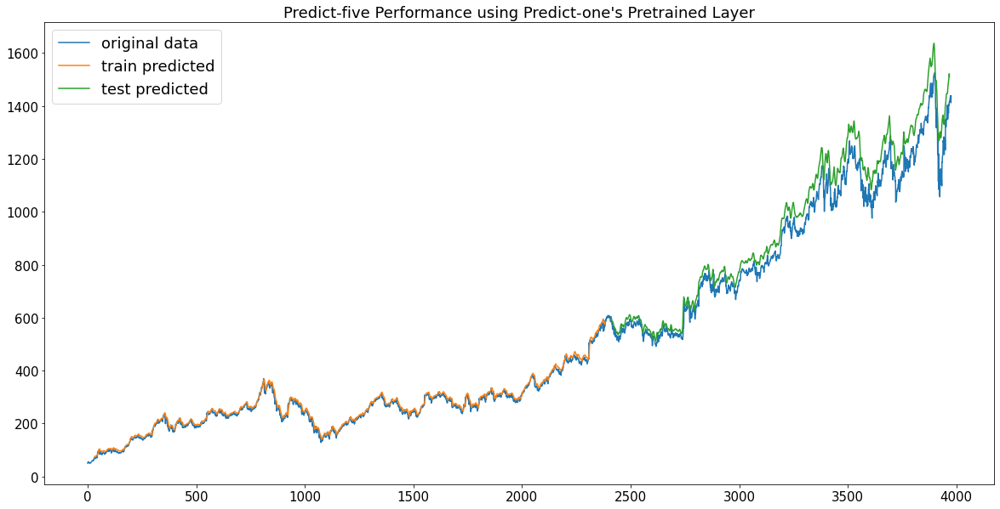

In [0]:
# add PredictOne pretrained layer
pretrainPrediction = StockPredictions(pretrain_lstm1)
pretrainPrediction.fit(log_dir="./logs1")
trainPredict, testPredict = pretrainPrediction.predict()
PredictOnetestPlot = pretrainPrediction.price_plot(trainPredict, testPredict, title='Predict-five Performance using Predict-one\'s Pretrained Layer')

Train Score: 9.30 RMSE
Test Score: 56.95 RMSE


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:73: RuntimeWarning: Mean of empty slice
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: Mean of empty slice


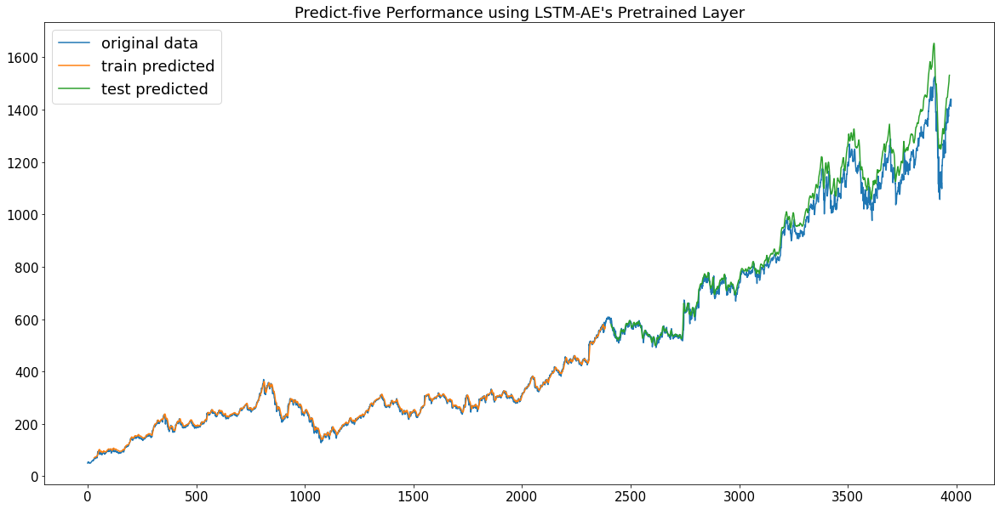

In [0]:
# add LSTMAE pretrained layer
pretrainPrediction1 = StockPredictions(pretrain_lstm2)
pretrainPrediction1.fit(log_dir="./logs2")
trainPredict, testPredict = pretrainPrediction1.predict()
LSTMAEPlot = pretrainPrediction1.price_plot(trainPredict, testPredict, title='Predict-five Performance using LSTM-AE\'s Pretrained Layer')

Train Score: 8.67 RMSE
Test Score: 70.99 RMSE


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:73: RuntimeWarning: Mean of empty slice
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:79: RuntimeWarning: Mean of empty slice


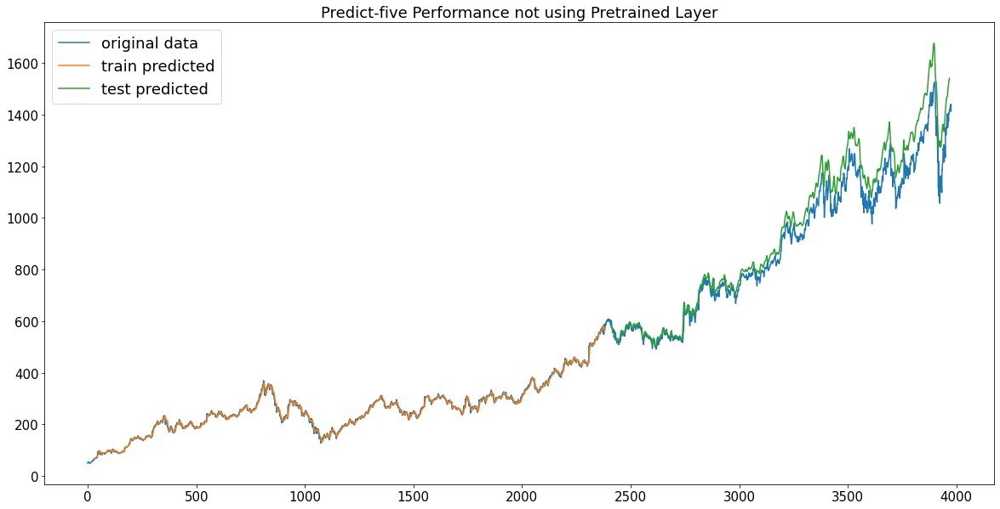

In [0]:
# not add pretrained layer
NotpretrainPrediction = StockPredictions()
NotpretrainPrediction.fit(log_dir="./logs3")
trainPredict, testPredict = NotpretrainPrediction.predict()
NotpretrainPlot = NotpretrainPrediction.price_plot(trainPredict, testPredict, title='Predict-five Performance not using Pretrained Layer')

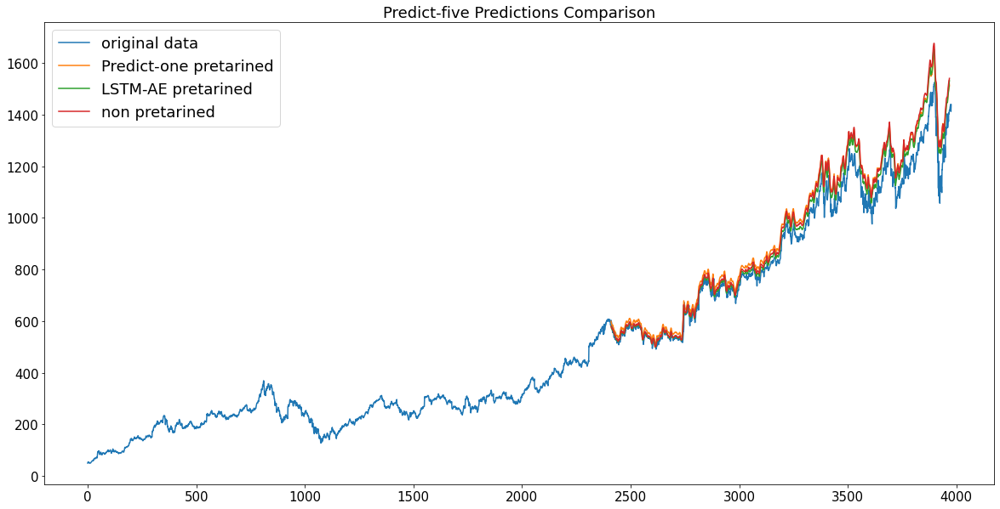

In [0]:
plt.figure(figsize = (20,10))
plt.plot(NotpretrainPrediction.dataset, label='original data')
plt.plot(PredictOnetestPlot, label='Predict-one pretarined')
plt.plot(LSTMAEPlot, label='LSTM-AE pretarined')
plt.plot(NotpretrainPlot, label='non pretarined')
plt.legend(loc='upper left', prop={'size': 18})
plt.title('Predict-five Predictions Comparison', fontsize=18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()

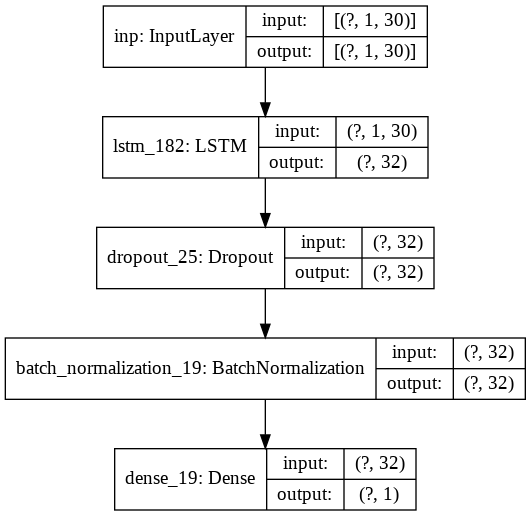

In [0]:
keras.utils.plot_model(PredictOne.model, show_shapes=True)

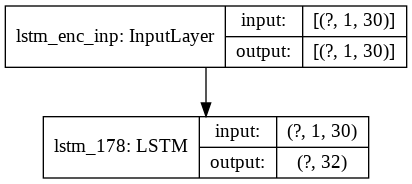

In [0]:
keras.utils.plot_model(lstmae.encoder, show_shapes=True)

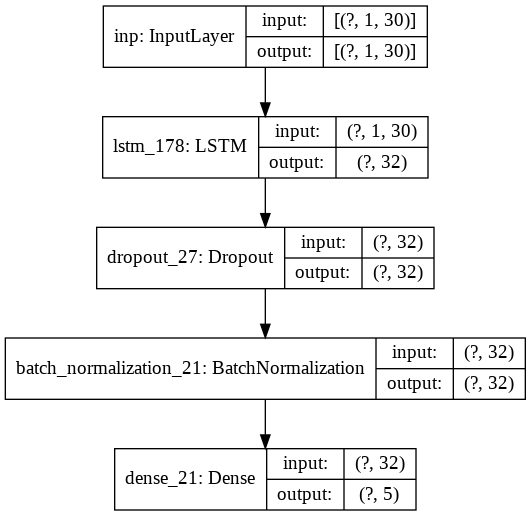

In [0]:
keras.utils.plot_model(pretrainPrediction1.model, show_shapes=True)

In [0]:
%tensorboard --logdir logs_Autoencoder/

Output hidden; open in https://colab.research.google.com to view.

In [0]:
%tensorboard --logdir logs_PredictOne/

Output hidden; open in https://colab.research.google.com to view.

In [0]:
%tensorboard --logdir logs1/

Output hidden; open in https://colab.research.google.com to view.

In [0]:
%tensorboard --logdir logs2/

Output hidden; open in https://colab.research.google.com to view.

In [0]:
%tensorboard --logdir logs3/

Output hidden; open in https://colab.research.google.com to view.